## Pretrained Model Resnet50 for Transfer

Import requirements:

In [78]:
import sys
assert sys.version_info >= (3, 7)

from packaging import version
import sklearn
assert version.parse(sklearn.__version__) >= version.parse("1.0.1")

import tensorflow as tf
assert version.parse(tf.__version__) >= version.parse("2.8.0")

import numpy as np

Let's make sure there's one, or else issue a warning:

In [79]:
# Is this notebook running on Colab or Kaggle?
IS_COLAB = "google.colab" in sys.modules

if not tf.config.list_physical_devices('GPU'):
    print("No GPU was detected. Neural nets can be very slow without a GPU.")
    if IS_COLAB:
        print("Go to Runtime > Change runtime and select a GPU hardware "
              "accelerator.")

No GPU was detected. Neural nets can be very slow without a GPU.
Go to Runtime > Change runtime and select a GPU hardware accelerator.


Cargamos el conjunto de datos:

In [80]:
import urllib
urllib.request.urlretrieve(
    'https://raw.githubusercontent.com/sergiomora03/AdvancedTopicsAnalytics/main/notebooks/img/ImportImagenesURL.py',
    'ImportImagenes.py'
  )

('ImportImagenes.py', <http.client.HTTPMessage at 0x79876e6578b0>)

In [81]:
from ImportImagenes import *
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

In [82]:
X,Y = import_imagenes()

In [104]:
CE_x, CV_x, CE_y, CV_y = train_test_split(X.T, Y.T, test_size = 0.3, random_state = 100)

CE_x = CE_x
CV_x = CV_x
CE_y = CE_y
CV_y = CV_y

n=CE_y.shape[1]
m=CV_y.shape[1]

print(CE_x.shape, CV_x.shape, CE_y.shape, CV_y.shape, n, m)

(175, 14700) (75, 14700) (175, 1) (75, 1) 1 1


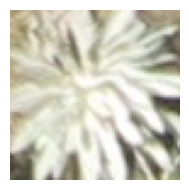

In [84]:
def display_images(CE_x, num_images):
  image_shape = (70,70,3)
  num_images = min(num_images, len(CE_x))
  plt.figure(figsize=(160,2))

  plt.imshow(CE_x[num_images].reshape(image_shape))
  plt.axis('off')

  plt.tight_layout()
  plt.show()

display_images(CE_x,1)

In [85]:
CE_x.shape

(175, 14700)

In [105]:
#Convertir X a un tensor con 4 dimensiones (número_de_imágenes, altura, ancho, canales)
CE_x = CE_x.reshape(CE_x.shape[0], 70, 70, 3)
CE_x = tf.convert_to_tensor(CE_x)

In [106]:
CE_x.shape

TensorShape([175, 70, 70, 3])

In [88]:
CE_y.shape

(175, 1)

# Using Pretrained Models from Keras

In [89]:
import tensorflow as tf
tf.keras.backend.clear_session()

In [90]:
model = tf.keras.applications.ResNet50(weights="imagenet")

In [107]:
images = CE_x
images_resized = []
for image in images:
  resized_image = tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True)(image)
  images_resized.append(resized_image)

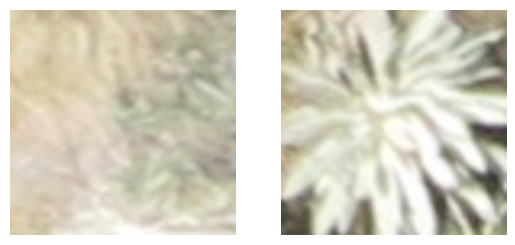

In [92]:
# extra code – displays the cropped and resized images

#plt.figure(figsize=(10, 6))
for idx in (0,1):
    plt.subplot(1, 2, idx + 1)
    plt.imshow(images_resized[idx])
    plt.axis("off")

plt.show()

In [108]:
# Convert the list of images to a tensor
images_resized = tf.convert_to_tensor(images_resized)

# Preprocess the images
inputs = tf.keras.applications.resnet50.preprocess_input(images_resized)

In [ ]:
Y_proba = model.predict(images_resized)
Y_proba.shape

In [ ]:
top_K = tf.keras.applications.resnet50.decode_predictions(Y_proba, top=3)

Image #0


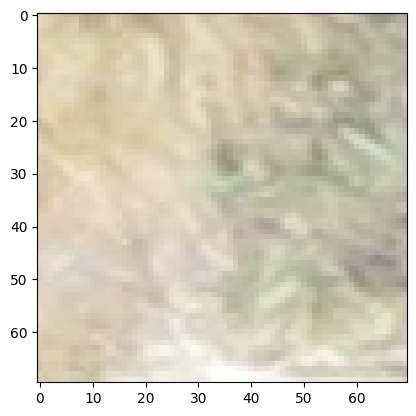

  n01930112 - nematode     14.80%
  n03041632 - cleaver      2.78%
  n03838899 - oboe         2.55%
Image #1


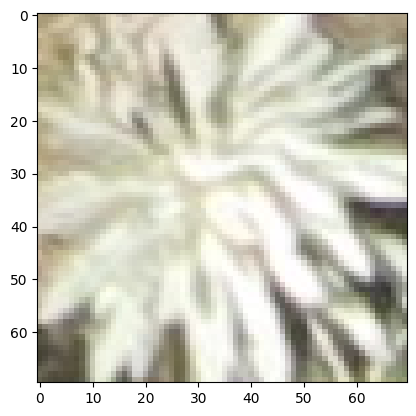

  n01930112 - nematode     14.48%
  n03041632 - cleaver      3.27%
  n03838899 - oboe         3.12%


In [ ]:
for image_index in range(0, 2):
    print(f"Image #{image_index}")

    # Display the original image
    plt.imshow(images[image_index])
    plt.show()

    for class_id, name, y_proba in top_K[image_index]:
        print(f"  {class_id} - {name:12s} {y_proba:.2%}")

# Pretrained Models for Transfer Learning

In [ ]:
tf.keras.backend.clear_session()  # extra code – resets layer name counter

In [109]:
#Realizamos el mismo pre-procesamiento en la data de test

CV_x = CV_x.reshape(CV_x.shape[0], 70, 70, 3)
CV_x = tf.convert_to_tensor(CV_x)
imagesV = CV_x
images_resizedV = []
for image in imagesV:
  resized_imageV = tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True)(image)
  images_resizedV.append(resized_imageV)

# Convert the list of images to a tensor
images_resizedV = tf.convert_to_tensor(images_resizedV)

# Preprocess the images
images_resizedV = tf.keras.applications.resnet50.preprocess_input(images_resizedV)

In [133]:
#Creación trainset
batch_size = 32

labels = np.array(CE_y)  #array de etiquetas de entrenamiento
labels_tensor = tf.convert_to_tensor(labels, dtype=tf.int64)

train_set = tf.data.Dataset.from_tensor_slices((images_resized, labels))
train_set = train_set.shuffle(buffer_size=1000).batch(batch_size).prefetch(1)

In [135]:
labels_tensor.shape

TensorShape([175, 1])

In [136]:
images_resized.shape

TensorShape([175, 224, 224, 3])

In [137]:
train_set

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 1), dtype=tf.int64, name=None))>

In [130]:
#Creación valid_set
labelsV = np.array(CV_y)  #array de etiquetas de validación
labels_tensorV = tf.convert_to_tensor(labelsV, dtype=tf.int64)

valid_set = tf.data.Dataset.from_tensor_slices((images_resizedV, labelsV))

In [128]:
labels_tensorV.shape

TensorShape([75, 1])

In [129]:
images_resizedV.shape

TensorShape([75, 224, 224, 3])

In [138]:
valid_set = valid_set.shuffle(buffer_size=1000).batch(batch_size).prefetch(1)

In [139]:
valid_set

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 1), dtype=tf.int64, name=None))>

In [112]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip(mode="horizontal", seed=42),
    tf.keras.layers.RandomRotation(factor=0.05, seed=42),
    tf.keras.layers.RandomContrast(factor=0.2, seed=42)
])

Try running the following cell multiple times to see different random data augmentations:

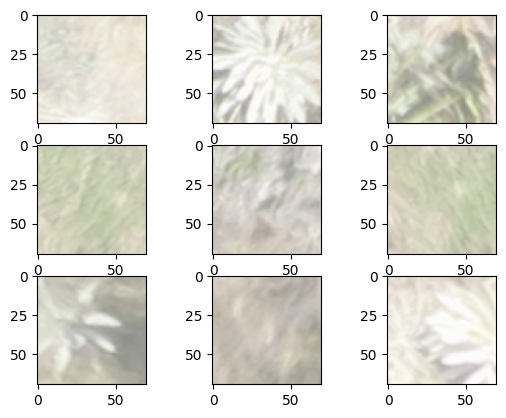

In [ ]:
# extra code – displays the same first 9 images, after augmentation

X_batch_augmented = data_augmentation(CE_x, training=True)
for index in range(9):
  plt.subplot(3, 3, index + 1)
  plt.imshow(np.clip((X_batch_augmented[index] + 1) / 2, 0, 1))
        # We must rescale the images to the 0-1 range for imshow(), and also
        # clip the result to that range, because data augmentation may
        # make some values go out of bounds (e.g., RandomContrast in this case).


plt.show()

Now let's load the pretrained model, without its top layers, and replace them with our own, for the flower classification task:

In [149]:
tf.random.set_seed(42)  # extra code – ensures reproducibility
base_model = tf.keras.applications.xception.Xception(weights="imagenet", include_top=False)

In [150]:
avg = tf.keras.layers.GlobalAveragePooling2D()(base_model.output)
output = tf.keras.layers.Dense(1, activation="sigmoid")(avg)
model = tf.keras.Model(inputs=base_model.input, outputs=output)

In [151]:
for layer in base_model.layers:
    layer.trainable = False

Let's train the model for a few epochs, while keeping the base model weights fixed:

In [152]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [153]:
history = model.fit(train_set, validation_data=valid_set, epochs=5)

Epoch 1/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 65s 10s/step - accuracy: 0.4395 - loss: 0.7179 - val_accuracy: 0.4267 - val_loss: 1.4542
Epoch 2/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 83s 11s/step - accuracy: 0.7755 - loss: 0.5951 - val_accuracy: 0.5733 - val_loss: 0.7060
Epoch 3/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 57s 10s/step - accuracy: 0.8390 - loss: 0.5180 - val_accuracy: 0.5733 - val_loss: 1.7417
Epoch 4/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 86s 11s/step - accuracy: 0.9054 - loss: 0.4460 - val_accuracy: 0.5733 - val_loss: 3.0462
Epoch 5/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 79s 10s/step - accuracy: 0.8711 - loss: 0.4038 - val_accuracy: 0.5733 - val_loss: 4.0986


In [157]:
for indices in zip(range(33), range(33, 66), range(66, 99), range(99, 132)):
    for idx in indices:
        print(f"{idx:3}: {base_model.layers[idx].name:22}", end="")
    print()

  0: input_layer_2          33: block4_pool            66: block8_sepconv1_act    99: block11_sepconv2_act  
  1: block1_conv1           34: batch_normalization_6  67: block8_sepconv1       100: block11_sepconv2      
  2: block1_conv1_bn        35: add_14                 68: block8_sepconv1_bn    101: block11_sepconv2_bn   
  3: block1_conv1_act       36: block5_sepconv1_act    69: block8_sepconv2_act   102: block11_sepconv3_act  
  4: block1_conv2           37: block5_sepconv1        70: block8_sepconv2       103: block11_sepconv3      
  5: block1_conv2_bn        38: block5_sepconv1_bn     71: block8_sepconv2_bn    104: block11_sepconv3_bn   
  6: block1_conv2_act       39: block5_sepconv2_act    72: block8_sepconv3_act   105: add_21                
  7: block2_sepconv1        40: block5_sepconv2        73: block8_sepconv3       106: block12_sepconv1_act  
  8: block2_sepconv1_bn     41: block5_sepconv2_bn     74: block8_sepconv3_bn    107: block12_sepconv1      
  9: block2_sepconv

Now that the weights of our new top layers are not too bad, we can make the top part of the base model trainable again, and continue training, but with a lower learning rate:

In [158]:
for layer in base_model.layers[56:]:
    layer.trainable = True

optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9)
model.compile(loss="binary_crossentropy", optimizer=optimizer,
              metrics=["accuracy"])
history = model.fit(train_set, validation_data=valid_set, epochs=5)
#model.fit(images_resized, labels, epochs=5, batch_size=32)

Epoch 1/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 162s 19s/step - accuracy: 0.7238 - loss: 0.5937 - val_accuracy: 0.5733 - val_loss: 2.3761
Epoch 2/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 142s 19s/step - accuracy: 0.9538 - loss: 0.3984 - val_accuracy: 0.5733 - val_loss: 1.6576
Epoch 3/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 141s 19s/step - accuracy: 1.0000 - loss: 0.1953 - val_accuracy: 0.5733 - val_loss: 2.3579
Epoch 4/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 141s 18s/step - accuracy: 1.0000 - loss: 0.0873 - val_accuracy: 0.5733 - val_loss: 3.5272
Epoch 5/5
6/6 ━━━━━━━━━━━━━━━━━━━━ 141s 18s/step - accuracy: 1.0000 - loss: 0.0346 - val_accuracy: 0.5733 - val_loss: 3.1124


In [162]:
#Evaluación del modelo (Revisión del accuracy obtenido)
scores = model.evaluate(train_set)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

6/6 ━━━━━━━━━━━━━━━━━━━━ 41s 6s/step - accuracy: 0.8402 - loss: 0.3988

compile_metrics: 82.86%


In [163]:
#Evaluación del modelo (Revisión del accuracy obtenido)
scores = model.evaluate(valid_set)
print("\n%s: %.2f%%" % (model.metrics_names[1], scores[1]*100))

3/3 ━━━━━━━━━━━━━━━━━━━━ 18s 6s/step - accuracy: 0.5562 - loss: 3.2356

compile_metrics: 57.33%


Prueba Cualitativa del modelo

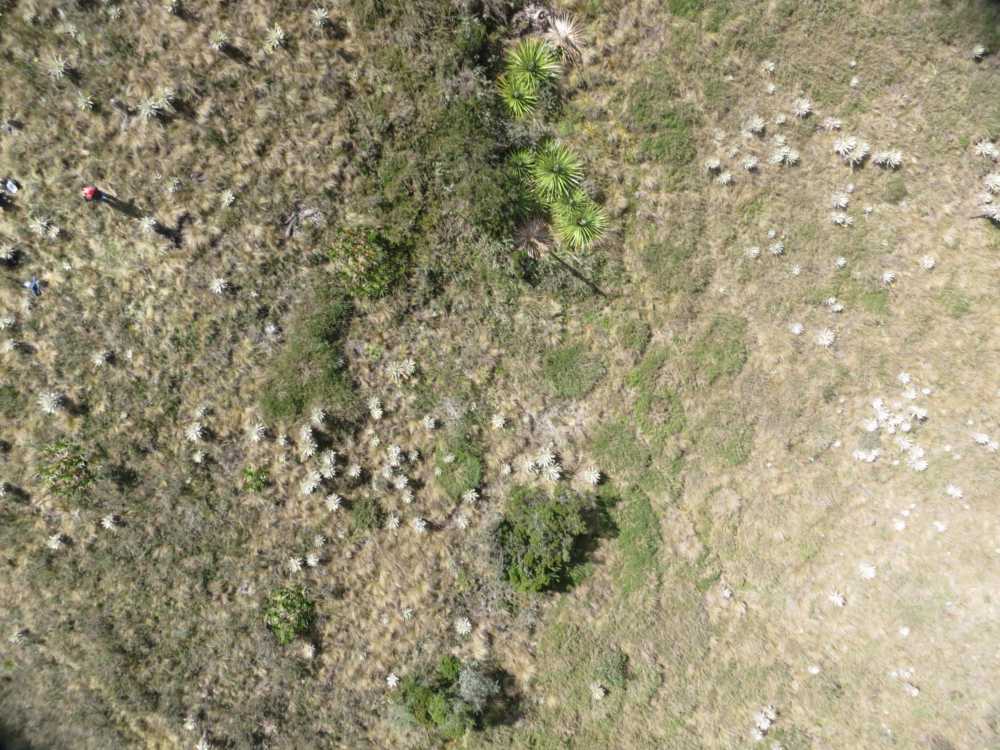

In [ ]:
from tensorflow.keras.utils import load_img # import load_img from the correct module

urllib.request.urlretrieve('https://github.com/sergiomora03/AdvancedTopicsAnalytics/blob/main/notebooks/img/IMG_3451.JPG?raw=true', 'IMG_3451.JPG')
img = load_img('IMG_3451.JPG')
img

In [ ]:
img.shape

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


<ipython-input-164-f937c8a80650>:25: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pred_P = int(model.predict(vec) > 0.5)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 237ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

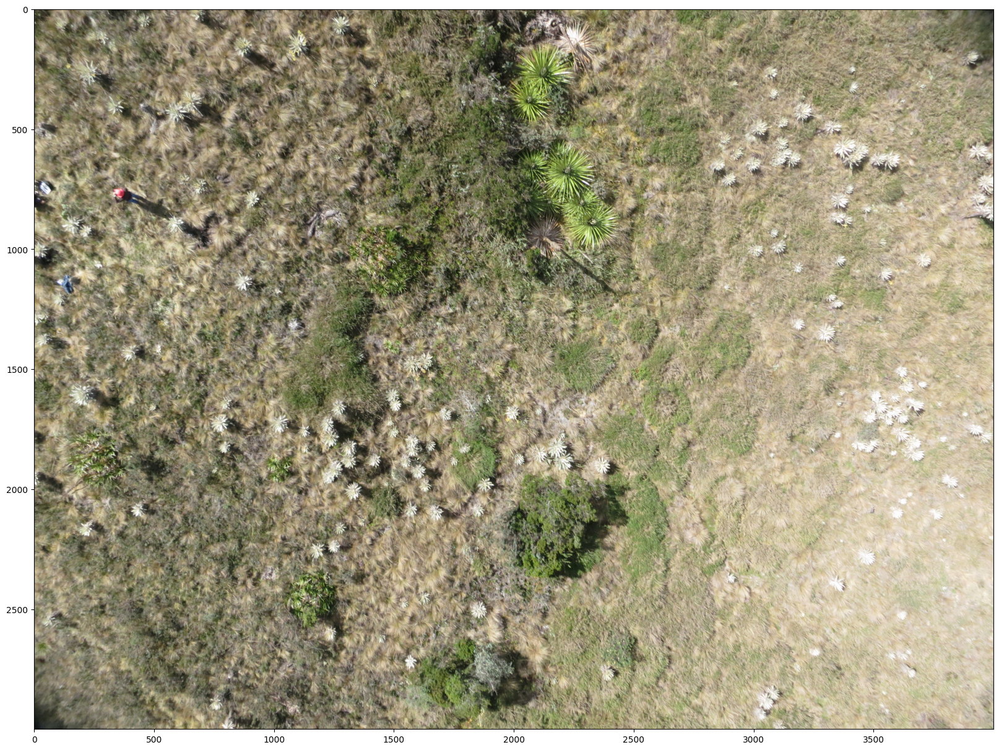

In [164]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        #subi=x[f1:f2,c1:c2,]
        #subi2=np.ndarray.flatten(subi).T/255.
        # ns=subi2.shape[0]
        vec=x[f1:f2,c1:c2,]

        vec = vec.reshape(1, 70, 70, 3)
        vec = tf.convert_to_tensor(vec)
        vec = tf.keras.layers.Resizing(height=224, width=224, crop_to_aspect_ratio=True)(vec)
        vec = tf.keras.applications.resnet50.preprocess_input(vec)
        #vec = tf.expand_dims(vec, axis=0)

        pred_P = int(model.predict(vec) > 0.5)
        #pred_P= red_neu.predict(vec.T)
        #pred_P=pred(param, vec)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50

plt.figure(figsize = (20,20))
plt.imshow(x2)